# Project 4: West Nile Virus Prediction
## Data Cleaning, Feature Engineering & EDA
   ---
  *By Ethan Koh,
      Grace Chia,
      Jocelyn Pok,
      Randy Neo,                    5 June 2020*

# Background

West Nile Virus <sup>1</sup> (WNV) is usually spread to humans through infected mosquitos. Around 20% of individuals who become infected with the virus develop symptoms ranging from a persistent fever, to serious neurological illnesses that can result in death.<br/>

In 2002, Chicago recorded it's first human incident of West Nile virus. By 2004 the City of Chicago and the Chicago Department of Public Health (CDPH) had built a comprehensive surveillance and control program that is still in effect today.<br/>

Every week from late spring through the fall, mosquitos in traps across the city are tested for the virus. The results of these tests influence when and where the city will spray ariel pesticides to reduce adult mosquito populations. Every week from Monday through Wednesday, these traps collect mosquitos, and the mosquitos are tested for the presence of West Nile virus before the week ends. The test results include the number of mosquitos, the mosquitos species, and whether West Nile virus is present in the cohort.

This project is from: https://www.kaggle.com/c/predict-west-nile-virus/overview.


# Problem Statement
Due to a recent outbreak of the West Nile Virus in the city of Chicago, the Data Science team at the Disease and Treatment Agency has been tasked by the
Centers for Disease Control (CDC) to develop a strategy to deploy the effective use of pesticides. Targeting spraying efforts to areas of high risk will help to mitigate future outbreaks.<br/>

Leveraging on weather, location, mosquito population and spraying data, we will build a binary classification model that predicts the presence of the West Nile Virus in the city of Chicago. The model that achieves the highest ROC AUC score on the validation set, will be selected as our production model. The model is also expected to outperform the baseline ROC AUC score of 0.5. A cost-benefit analysis will also be done to determine if the benefits of spraying outweighs its costs.

# Data Sets

- **Train and Test data**<br/>
The training set consists of data from 2007, 2009, 2011, and 2013, while in the test set you are requested to predict the test results for 2008, 2010, 2012, and 2014. Not all the locations are tested at all times. Also, records exist only when a particular species of mosquitoes is found at a certain trap at a certain time.

|Feature|Description|
|---|---|
|Id| the id of the record|
|Date| date that the WNV test is performed|
|Address| approximate address of the location of trap. This is used to send to the GeoCoder |
|Species| the species of mosquitos|
|Block| block number of address|
|Street| street name|
|Trap| Id of the trap|
|AddressNumberAndStreet|approximate address returned from GeoCoder|
|Latitude, Longitude| Latitude and Longitude returned from GeoCoder|
|AddressAccuracy| accuracy returned from GeoCoder|
|NumMosquitos| number of mosquitoes caught in this trap|
|WnvPresent|whether West Nile Virus was present in these mosquitos. 1 means WNV is present, and 0 means not present|

- **Map Data**<br/>
The map files mapdata_copyright_openstreetmap_contributors.rds and mapdata_copyright_openstreetmap_contributors.txt are from Open Streetmap,primarily provided for use in visualizations.
<br/><br/>
- **Weather Data** <br/>
NOAA's National Centers for Environmental Information (NCEI)<sup>2</sup> is responsible for preserving, monitoring, assessing, and providing public access to the Nation's treasure of climate and historical weather data and information.<br/>
This dataset contains weather conditions from NOAA from months of 2007 to 2014. <br/>
The stations captured:<br/>
Station 1: Chicago O'hare International Airport :<br/>Lat: 41.995 Lon: -87.933 Elev: 662 ft. above sea level <br/>
Station 2: Chicago Midway Intl Arpt :<br/>Lat: 41.786 Lon: -87.752 Elev: 612 ft. above sea level.<br/>
Column descriptions are in noaa_weather_qclcd_documentation.pdf. 
<br/><br/>
- **Spray Data**<br/>
Geographic Information Systems (GIS) data of spraying efforts in 2011 and 2013 to reduce the number of mosquitos in the area, and therefore thus reduce the presence of West Nile virus. 

|Feature|Description|
|---|---|
|Date, Time|date and time of the spray|
|Latitude, Longitude| the Latitude and Longitude of the spray|

- **Sample Submission**<br/>
A sample submission file in the correct format for kaggle submission. For each Id in the test set, we should predict a real-valued probability that WNV is present. 

# Contents

- [Import Libraries](#Import-Libraries)
- [Load Data](#Load-Data)
- [Data Cleaning](#Data-Cleaning)
- [Feature Engineering](#Feature-Engineering)
- [EDA](#EDA)
- [Prepare Train and Test Set](#Prepare-Train-and-Test-Set)

# Import Libraries

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.cluster import DBSCAN
from sklearn.ensemble import RandomForestClassifier

import plotly.express as px # Install plotly using 'conda install -c plotly plotly'
import geopy.distance # Install geopy using 'conda install -c conda-forge geopy'

pd.set_option('max_columns', None)
pd.set_option('max_rows', None)

%matplotlib inline

# Load Data

The train and test data sets contain information from mosquito traps around Chicago, with date, location, and species data for each. The train data set has two additional features compared to the test data set - the number of mosquitoes and whether West Nile Virus is present.

In [2]:
# Read in train dataset and parse dates
train = pd.read_csv('../data/train.csv', parse_dates=['Date'])

In [3]:
# Display top 5 train data
train.head()

,Date,Address,Species,Block,Street,Trap,AddressNumberAndStreet,Latitude,Longitude,AddressAccuracy,NumMosquitos,WnvPresent
0,2007-05-29,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX PIPIENS/RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.954690,-87.800991,9,1,0
1,2007-05-29,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.954690,-87.800991,9,1,0
2,2007-05-29,"6200 North Mandell Avenue, Chicago, IL 60646, USA",CULEX RESTUANS,62,N MANDELL AVE,T007,"6200 N MANDELL AVE, Chicago, IL",41.994991,-87.769279,9,1,0
3,2007-05-29,"7900 West Foster Avenue, Chicago, IL 60656, USA",CULEX PIPIENS/RESTUANS,79,W FOSTER AVE,T015,"7900 W FOSTER AVE, Chicago, IL",41.974089,-87.824812,8,1,0
4,2007-05-29,"7900 West Foster Avenue, Chicago, IL 60656, USA",CULEX RESTUANS,79,W FOSTER AVE,T015,"7900 W FOSTER AVE, Chicago, IL",41.974089,-87.824812,8,4,0


In [4]:
# No null values for train
# Correct datatypes
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10506 entries, 0 to 10505
Data columns (total 12 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   Date                    10506 non-null  datetime64[ns]
 1   Address                 10506 non-null  object        
 2   Species                 10506 non-null  object        
 3   Block                   10506 non-null  int64         
 4   Street                  10506 non-null  object        
 5   Trap                    10506 non-null  object        
 6   AddressNumberAndStreet  10506 non-null  object        
 7   Latitude                10506 non-null  float64       
 8   Longitude               10506 non-null  float64       
 9   AddressAccuracy         10506 non-null  int64         
 10  NumMosquitos            10506 non-null  int64         
 11  WnvPresent              10506 non-null  int64         
dtypes: datetime64[ns](1), float64(2), int64(4), ob

In [5]:
# Display train shape
train.shape

(10506, 12)

In [6]:
# Read in spray dataset and parse dates
spray = pd.read_csv('../data/spray.csv', parse_dates=['Date'])

In [7]:
# Display top 5 spray data
spray.head()

,Date,Time,Latitude,Longitude
0,2011-08-29,6:56:58 PM,42.391623,-88.089163
1,2011-08-29,6:57:08 PM,42.391348,-88.089163
2,2011-08-29,6:57:18 PM,42.391022,-88.089157
3,2011-08-29,6:57:28 PM,42.390637,-88.089158
4,2011-08-29,6:57:38 PM,42.390410,-88.088858


In [8]:
# Some null values in the Time column
spray.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14835 entries, 0 to 14834
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   Date       14835 non-null  datetime64[ns]
 1   Time       14251 non-null  object        
 2   Latitude   14835 non-null  float64       
 3   Longitude  14835 non-null  float64       
dtypes: datetime64[ns](1), float64(2), object(1)
memory usage: 463.7+ KB


In [9]:
# Display spray shape
spray.shape

(14835, 4)

In [10]:
# Read in weather dataset and parse dates
weather = pd.read_csv('../data/weather.csv', parse_dates=['Date'])

In [11]:
# Display top 5 weather data
weather.head()

,Station,Date,Tmax,Tmin,Tavg,Depart,DewPoint,WetBulb,Heat,Cool,Sunrise,Sunset,CodeSum,Depth,Water1,SnowFall,PrecipTotal,StnPressure,SeaLevel,ResultSpeed,ResultDir,AvgSpeed
0,1,2007-05-01,83,50,67,14,51,56,0,2,0448,1849,,0,M,0.0,0.00,29.10,29.82,1.7,27,9.2
1,2,2007-05-01,84,52,68,M,51,57,0,3,-,-,,M,M,M,0.00,29.18,29.82,2.7,25,9.6
2,1,2007-05-02,59,42,51,-3,42,47,14,0,0447,1850,BR,0,M,0.0,0.00,29.38,30.09,13.0,4,13.4
3,2,2007-05-02,60,43,52,M,42,47,13,0,-,-,BR HZ,M,M,M,0.00,29.44,30.08,13.3,2,13.4
4,1,2007-05-03,66,46,56,2,40,48,9,0,0446,1851,,0,M,0.0,0.00,29.39,30.12,11.7,7,11.9


In [12]:
# Some of the datatypes like Tavg and AvgSpeed should be numeric, but they are appearing as object types
# We will need to amend this during data cleaning
weather.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2944 entries, 0 to 2943
Data columns (total 22 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Station      2944 non-null   int64         
 1   Date         2944 non-null   datetime64[ns]
 2   Tmax         2944 non-null   int64         
 3   Tmin         2944 non-null   int64         
 4   Tavg         2944 non-null   object        
 5   Depart       2944 non-null   object        
 6   DewPoint     2944 non-null   int64         
 7   WetBulb      2944 non-null   object        
 8   Heat         2944 non-null   object        
 9   Cool         2944 non-null   object        
 10  Sunrise      2944 non-null   object        
 11  Sunset       2944 non-null   object        
 12  CodeSum      2944 non-null   object        
 13  Depth        2944 non-null   object        
 14  Water1       2944 non-null   object        
 15  SnowFall     2944 non-null   object        
 16  Precip

In [13]:
# display weather shape
weather.shape

(2944, 22)

In [14]:
# Read in test dataset and parse dates
test = pd.read_csv('../data/test.csv', parse_dates=['Date'])

In [15]:
# Display top 5 test data
test.head()

,Id,Date,Address,Species,Block,Street,Trap,AddressNumberAndStreet,Latitude,Longitude,AddressAccuracy
0,1,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX PIPIENS/RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9
1,2,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9
2,3,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX PIPIENS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9
3,4,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX SALINARIUS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9
4,5,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX TERRITANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9


In [16]:
# No null values for Test set
# Correct datatypes
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 116293 entries, 0 to 116292
Data columns (total 11 columns):
 #   Column                  Non-Null Count   Dtype         
---  ------                  --------------   -----         
 0   Id                      116293 non-null  int64         
 1   Date                    116293 non-null  datetime64[ns]
 2   Address                 116293 non-null  object        
 3   Species                 116293 non-null  object        
 4   Block                   116293 non-null  int64         
 5   Street                  116293 non-null  object        
 6   Trap                    116293 non-null  object        
 7   AddressNumberAndStreet  116293 non-null  object        
 8   Latitude                116293 non-null  float64       
 9   Longitude               116293 non-null  float64       
 10  AddressAccuracy         116293 non-null  int64         
dtypes: datetime64[ns](1), float64(2), int64(3), object(5)
memory usage: 9.8+ MB


In [17]:
# Display test shape
test.shape

(116293, 11)

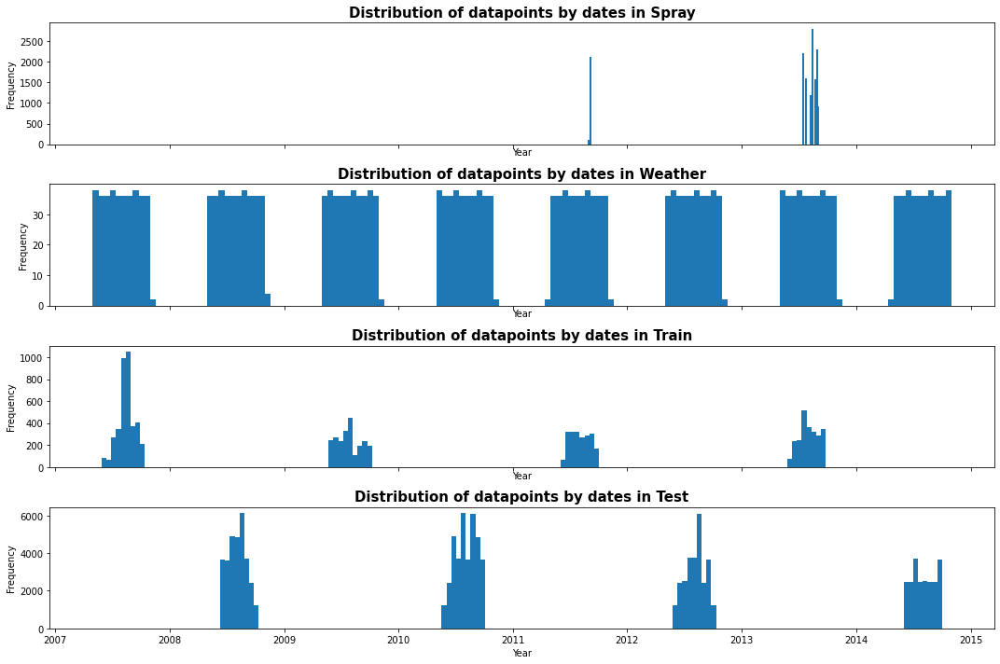

In [18]:
# Plot histogram subplots to compare the date range across the 4 data sets
fig, ax = plt.subplots(4,1, figsize=(15,10), sharex=True)

df_list = [spray, weather, train, test] # List of our dataframes
title_list = ['Spray', 'Weather', 'Train', 'Test']

for i, df in enumerate(df_list):
    ax[i].hist(df['Date'], bins=150)
    ax[i].set_title('Distribution of datapoints by dates in ' + str(title_list[i]), size=15, weight='bold')
    ax[i].set_ylabel('Frequency')
    ax[i].set_xlabel('Year')

plt.tight_layout()

Spray data is rather limited, with only 10 days of spraying in 2011 and 2013. Weather data is provided for the weather conditions of 2007-2014, during the months of the train and test data sets.
Training data set contains the odd-numbered years, 2007, 2009, 2011 and 2013. On the other hand, the test set for prediciton consists of the even-numbered years, 2008, 2010, 2012 and 2014. There is no indication that this is the complete spray data for each year.

# Data Cleaning

## Data Cleaning: Weather

The weather data has some null values (represented by 'M') and some trace values(represented by 'T). There are also features that are not relevant and can be dropped (e.g. 'SnowFall'). There are also many columns that are of object data types that will need to be converted to float and integer type.

In [19]:
# Correct missing values
for col in weather.columns:
    # 'M' and '-' are missing values, we will replace this will NaN
    weather[col].replace('M', np.nan, inplace=True)
    weather[col].replace('-', np.nan, inplace=True)
    # The blank in 'CodeSum' represents 'Moderate'
    weather[col].replace(" ", 'Moderate',inplace=True)
    # 'T' represents the Trace amount of precipitation, which is 0.005
    weather[col].replace('  T', 0.005, inplace=True)

In [20]:
# View first 5 rows of the weather dataset. We observe that there are some null values.
weather.head()

,Station,Date,Tmax,Tmin,Tavg,Depart,DewPoint,WetBulb,Heat,Cool,Sunrise,Sunset,CodeSum,Depth,Water1,SnowFall,PrecipTotal,StnPressure,SeaLevel,ResultSpeed,ResultDir,AvgSpeed
0,1,2007-05-01,83,50,67,14,51,56,0,2,0448,1849,Moderate,0,NaN,0.0,0.00,29.10,29.82,1.7,27,9.2
1,2,2007-05-01,84,52,68,NaN,51,57,0,3,NaN,NaN,Moderate,NaN,NaN,NaN,0.00,29.18,29.82,2.7,25,9.6
2,1,2007-05-02,59,42,51,-3,42,47,14,0,0447,1850,BR,0,NaN,0.0,0.00,29.38,30.09,13.0,4,13.4
3,2,2007-05-02,60,43,52,NaN,42,47,13,0,NaN,NaN,BR HZ,NaN,NaN,NaN,0.00,29.44,30.08,13.3,2,13.4
4,1,2007-05-03,66,46,56,2,40,48,9,0,0446,1851,Moderate,0,NaN,0.0,0.00,29.39,30.12,11.7,7,11.9


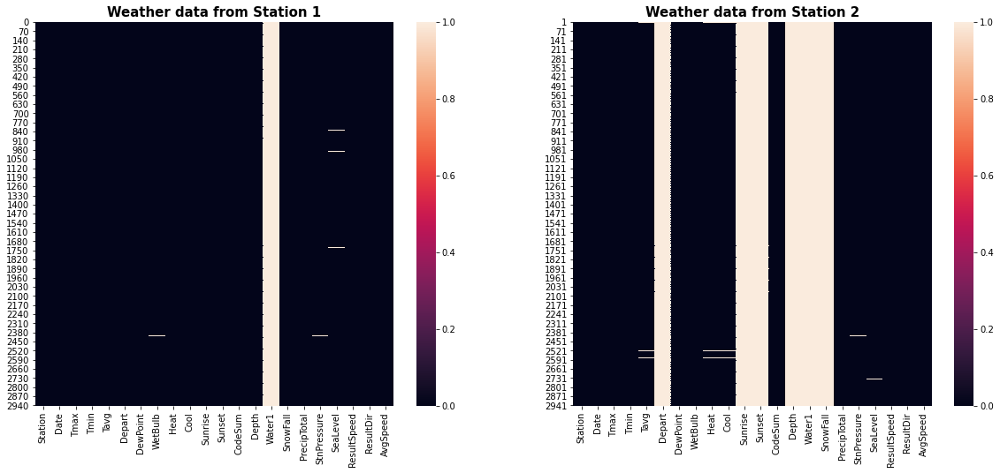

In [21]:
fig, ax = plt.subplots(1,2,figsize=(20,8))

# Plot heatmap of missing values in Station 1
sns.heatmap(weather[weather['Station']==1].isnull(), ax=ax[0])
ax[0].set_title('Weather data from Station 1', fontsize=15, fontweight='bold')

# Plot heatmap of missing values in Station 2
sns.heatmap(weather[weather['Station']==2].isnull(), ax=ax[1])
ax[1].set_title('Weather data from Station 2', fontsize=15, fontweight='bold');

There are a couple of null values in the weather dataset, largely a result of the missing values from Station 2. The EDAs in the next section show that the largest WNV hotspot in 2011 and 2013 is very close to Station 1. Furthermore, as the variance between weather stations is small, there will not be any significant impact from just using one weather station's values. 

In the event that there are missing values in Station 1, we will impute these with Station 2's. Columns with a lot of null values or 0 values like 'Depth', 'Water1', 'SnowFall', will be dropped.

In [22]:
# Fill missing Tavg values by taking the average of Tmax and Tmin
weather['Tavg'].fillna(((weather['Tmax'] + weather['Tmin'])/2),inplace=True)

In [23]:
# Convert Tavg to float type
weather['Tavg'] = weather['Tavg'].astype('float')

In [24]:
# Check for null values in WetBulb
weather[weather['WetBulb'].isnull()]

,Station,Date,Tmax,Tmin,Tavg,Depart,DewPoint,WetBulb,Heat,Cool,Sunrise,Sunset,CodeSum,Depth,Water1,SnowFall,PrecipTotal,StnPressure,SeaLevel,ResultSpeed,ResultDir,AvgSpeed
848,1,2009-06-26,86,69,78.0,7,60,NaN,0,13,0418,1931,Moderate,0,NaN,0.0,0.00,NaN,29.85,6.4,4,8.2
2410,1,2013-08-10,81,64,73.0,0,57,NaN,0,8,0454,1900,Moderate,0,NaN,0.0,0.00,NaN,30.08,5.3,5,6.5
2412,1,2013-08-11,81,60,71.0,-2,61,NaN,0,6,0455,1859,RA,0,NaN,0.0,0.01,29.35,30.07,2.0,27,3.0
2415,2,2013-08-12,85,69,77.0,NaN,63,NaN,0,12,NaN,NaN,RA,NaN,NaN,NaN,0.66,29.27,29.92,4.5,26,7.7


In [25]:
# Fill station 1's wetbulb with station 2's
weather.loc[848,'WetBulb'] = weather.loc[849,'WetBulb']
weather.loc[2410,'WetBulb'] = weather.loc[2411,'WetBulb']
weather.loc[2412,'WetBulb'] = weather.loc[2413,'WetBulb']

In [26]:
# show data with StnPressure missing
weather[weather['StnPressure'].isnull()]

,Station,Date,Tmax,Tmin,Tavg,Depart,DewPoint,WetBulb,Heat,Cool,Sunrise,Sunset,CodeSum,Depth,Water1,SnowFall,PrecipTotal,StnPressure,SeaLevel,ResultSpeed,ResultDir,AvgSpeed
87,2,2007-06-13,86,68,77.0,NaN,53,62,0,12,NaN,NaN,Moderate,NaN,NaN,NaN,0.00,NaN,NaN,7.0,5,NaN
848,1,2009-06-26,86,69,78.0,7,60,67,0,13,0418,1931,Moderate,0,NaN,0.0,0.00,NaN,29.85,6.4,4,8.2
2410,1,2013-08-10,81,64,73.0,0,57,63,0,8,0454,1900,Moderate,0,NaN,0.0,0.00,NaN,30.08,5.3,5,6.5
2411,2,2013-08-10,81,68,75.0,NaN,55,63,0,10,NaN,NaN,Moderate,NaN,NaN,NaN,0.00,NaN,30.07,6.0,6,7.4


In [27]:
# Fill station 1's StnPressure with station 2's
weather.loc[848,'StnPressure'] = weather.loc[849,'StnPressure']

# Both station and 2 StnPressure is NA for row index 2410 and 2411. We will fill station 1's StnPressure with the prior day's value
weather.loc[2410,'StnPressure'] = weather.loc[2408,'WetBulb']

In [28]:
# Check for null values in SeaLevel
weather[weather['SeaLevel'].isnull()]

,Station,Date,Tmax,Tmin,Tavg,Depart,DewPoint,WetBulb,Heat,Cool,Sunrise,Sunset,CodeSum,Depth,Water1,SnowFall,PrecipTotal,StnPressure,SeaLevel,ResultSpeed,ResultDir,AvgSpeed
87,2,2007-06-13,86,68,77.0,NaN,53,62,0,12,NaN,NaN,Moderate,NaN,NaN,NaN,0.00,NaN,NaN,7.0,5,NaN
832,1,2009-06-18,80,61,71.0,1,63,67,0,6,0416,1929,RA BR,0,NaN,0.0,0.12,29.08,NaN,6.7,16,7.9
994,1,2009-09-07,77,59,68.0,1,59,62,0,3,0523,1817,BR,0,NaN,0.0,0.00,29.39,NaN,5.8,3,4.0
1732,1,2011-09-08,75,57,66.0,0,53,59,0,1,0524,1815,RA,0,NaN,0.0,0.005,29.34,NaN,13.0,2,13.4
1745,2,2011-09-14,60,48,54.0,NaN,45,51,11,0,NaN,NaN,RA BR HZ FU,NaN,NaN,NaN,0.005,29.47,NaN,6.0,32,NaN
1756,1,2011-09-20,74,49,62.0,0,54,58,3,0,0537,1753,MIFG BCFG BR,0,NaN,0.0,0.00,29.26,NaN,7.3,18,7.3
2067,2,2012-08-22,84,72,78.0,NaN,51,61,NaN,NaN,NaN,NaN,Moderate,NaN,NaN,NaN,0.00,29.39,NaN,4.7,19,NaN
2090,1,2012-09-03,88,71,80.0,12,70,73,0,15,0519,1824,BR,0,NaN,0.0,0.00,29.17,NaN,4.6,6,4.4
2743,2,2014-07-23,76,64,70.0,NaN,56,61,0,5,NaN,NaN,Moderate,NaN,NaN,NaN,0.00,29.47,NaN,16.4,2,16.7


In [29]:
# Fill station 1's missing SeaLevel values using station 2's
weather['SeaLevel'].fillna(method='bfill', inplace=True)

In [30]:
# Drop columns with a lot of null values and 0s since they will not be useful in modeling
weather.drop(['Depth','Water1','SnowFall'], axis=1, inplace=True)

# Drop CodeSum too as it just a descriptor for the weather
weather.drop(['CodeSum'], axis=1, inplace=True)

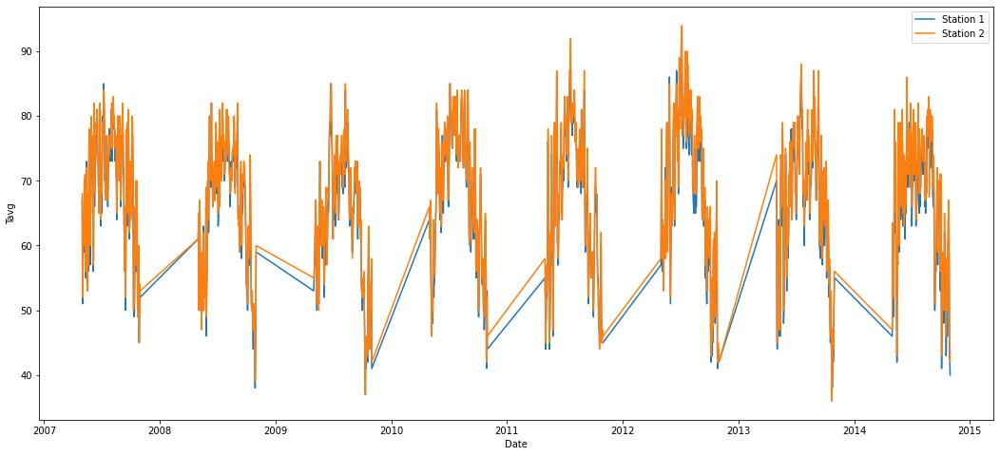

In [31]:
# Tavg for station 1 and 2 are very similar over the years 
# As the variance between weather stations is very small, we can just using station 1's weather data for modeling.
plt.figure(figsize=(18,8))
sns.lineplot(x='Date', y='Tavg', data=weather[weather['Station']==1], label='Station 1')
sns.lineplot(x='Date', y='Tavg', data=weather[weather['Station']==2], label='Station 2');

In [32]:
# Station 1 will be used for modeling as it is nearer to the WNV hotspot in the later years and variance between the two stations is minute
weather = weather.drop(weather[weather['Station'] == 2].index)

In [33]:
# Convert values to float or int
cols_to_float = ['Depart', 'WetBulb', 'Heat', 'Cool', 'PrecipTotal', 'StnPressure', 'SeaLevel', 'ResultDir', 'AvgSpeed']
for col in cols_to_float:
    weather[col] = weather[col].astype(float)

cols_to_int = ['Sunrise', 'Sunset']
for col in cols_to_int:
    weather[col] = weather[col].astype(int)

In [34]:
# Check that there are no more null values
weather.isnull().sum()

Station        0
Date           0
Tmax           0
Tmin           0
Tavg           0
Depart         0
DewPoint       0
WetBulb        0
Heat           0
Cool           0
Sunrise        0
Sunset         0
PrecipTotal    0
StnPressure    0
SeaLevel       0
ResultSpeed    0
ResultDir      0
AvgSpeed       0
dtype: int64

In [35]:
# Check that data types are correct - only float, int and datetime
weather.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1472 entries, 0 to 2942
Data columns (total 18 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Station      1472 non-null   int64         
 1   Date         1472 non-null   datetime64[ns]
 2   Tmax         1472 non-null   int64         
 3   Tmin         1472 non-null   int64         
 4   Tavg         1472 non-null   float64       
 5   Depart       1472 non-null   float64       
 6   DewPoint     1472 non-null   int64         
 7   WetBulb      1472 non-null   float64       
 8   Heat         1472 non-null   float64       
 9   Cool         1472 non-null   float64       
 10  Sunrise      1472 non-null   int64         
 11  Sunset       1472 non-null   int64         
 12  PrecipTotal  1472 non-null   float64       
 13  StnPressure  1472 non-null   float64       
 14  SeaLevel     1472 non-null   float64       
 15  ResultSpeed  1472 non-null   float64       
 16  Result

In [36]:
# Display top 5 rows in weather
weather.head()

,Station,Date,Tmax,Tmin,Tavg,Depart,DewPoint,WetBulb,Heat,Cool,Sunrise,Sunset,PrecipTotal,StnPressure,SeaLevel,ResultSpeed,ResultDir,AvgSpeed
0,1,2007-05-01,83,50,67.0,14.0,51,56.0,0.0,2.0,448,1849,0.000,29.10,29.82,1.7,27.0,9.2
2,1,2007-05-02,59,42,51.0,-3.0,42,47.0,14.0,0.0,447,1850,0.000,29.38,30.09,13.0,4.0,13.4
4,1,2007-05-03,66,46,56.0,2.0,40,48.0,9.0,0.0,446,1851,0.000,29.39,30.12,11.7,7.0,11.9
6,1,2007-05-04,66,49,58.0,4.0,41,50.0,7.0,0.0,444,1852,0.005,29.31,30.05,10.4,8.0,10.8
8,1,2007-05-05,66,53,60.0,5.0,38,49.0,5.0,0.0,443,1853,0.005,29.40,30.10,11.7,7.0,12.0


## Data Cleaning: Train

In [37]:
# Drop columns which are related to Address. We will use Latitude and Longitude instead since it is more accurate.
train.drop(['Address', 'Block', 'AddressNumberAndStreet', 'AddressAccuracy'], axis=1, inplace=True)

In [38]:
# Check that those columns have been dropped
train.head()

,Date,Species,Street,Trap,Latitude,Longitude,NumMosquitos,WnvPresent
0,2007-05-29,CULEX PIPIENS/RESTUANS,N OAK PARK AVE,T002,41.954690,-87.800991,1,0
1,2007-05-29,CULEX RESTUANS,N OAK PARK AVE,T002,41.954690,-87.800991,1,0
2,2007-05-29,CULEX RESTUANS,N MANDELL AVE,T007,41.994991,-87.769279,1,0
3,2007-05-29,CULEX PIPIENS/RESTUANS,W FOSTER AVE,T015,41.974089,-87.824812,1,0
4,2007-05-29,CULEX RESTUANS,W FOSTER AVE,T015,41.974089,-87.824812,4,0


# Feature Engineering

## Feature Engineering: Train

Warm weather conditions in the summer months are more likely to promote WNV. As such, we will breakdown the Date column into more granularity - day, week, month and year. This will help us to identify any effects of seasonality.

In [39]:
# Breakdown the Date into day, week, month and year to account for the seasonality effect of mosquito breeding and WNV
train['day'] = train['Date'].dt.dayofyear
train['week'] = train['Date'].dt.week
train['month'] = train['Date'].dt.month
train['year'] = train['Date'].dt.year

In [40]:
# Sense check new columns
train[['Date','day','week','month','year']].head()

,Date,day,week,month,year
0,2007-05-29,149,22,5,2007
1,2007-05-29,149,22,5,2007
2,2007-05-29,149,22,5,2007
3,2007-05-29,149,22,5,2007
4,2007-05-29,149,22,5,2007


## Feature Engineering: Weather

The weather dataset represents the bulk of the data available for both train and test data sets, and feature engineering will primarily take place there. Features such as rolling averages, sunlight duration and categorizing light and heavy rain days will be explored. 

In [41]:
# Create a column for sunlight duration in a day
weather['day_length'] = weather['Sunset'] - weather['Sunrise']

# Drop sunrise and sunset
weather.drop(['Sunset','Sunrise'], axis=1, inplace=True)

Understanding the conditions preferable for mosquito population growth can help us gain insights from the weather condition. Bodies of water are ideal breeding spots for mosquitos, as such the amount of precipitation will be investigated. Features factoring in the frequency of light rain and heavy rain in the last 14 days are generated to analyse the mosquito population when there was rain. 

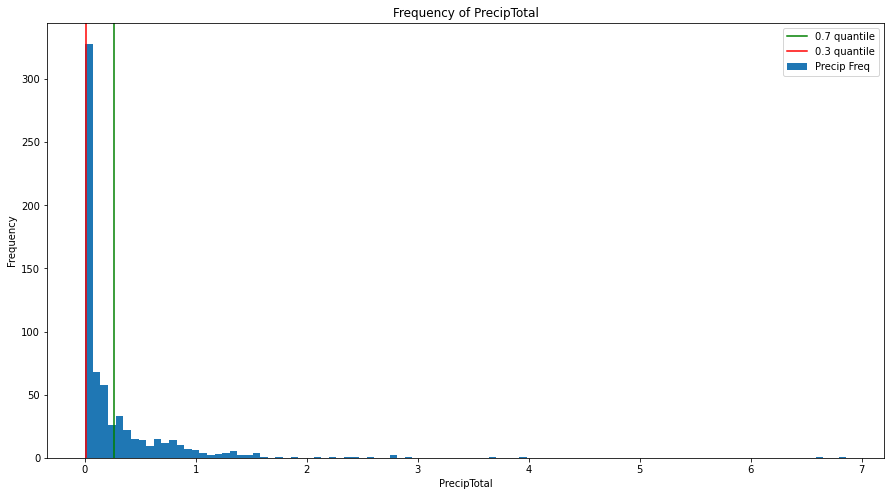

In [42]:
# Plot to decide what quantile to use to constitute heavy rain and light rain 
plt.figure(figsize=(15,8))
plt.hist(weather[weather['PrecipTotal'] > 0]['PrecipTotal'],bins=100)
plt.axvline(weather[weather['PrecipTotal'] > 0]['PrecipTotal'].quantile(0.7),color='green')
plt.axvline(weather[weather['PrecipTotal'] > 0]['PrecipTotal'].quantile(0.3),color='red')
plt.xlabel('PrecipTotal')
plt.ylabel('Frequency')
plt.title('Frequency of PrecipTotal')
plt.legend(('0.7 quantile',
            '0.3 quantile',
            'Precip Freq'));
# There is more meaningful split when used 70 and 30 for heavy and light rain respectively

In [43]:
# Create columns for light and heavy rain days based on quantile of rainy days
precip_70quantile = weather[weather['PrecipTotal'] > 0]['PrecipTotal'].quantile(.7) #heavy rain day defined as 70th quantile or above of rainy days
precip_30quantile = weather[weather['PrecipTotal'] > 0]['PrecipTotal'].quantile(.3) #light rain day defined as 30th quantile or below of rainy days

In [44]:
weather['heavy_rain'] = (weather['PrecipTotal']>precip_70quantile)
weather['light_rain'] = ((weather['PrecipTotal']>0) & (weather['PrecipTotal']<precip_30quantile))

In [45]:
light_rain_col_list = []
heavy_rain_col_list = []
for i in range(1,15):
    weather['light_rain_' + str(i) + '_days_ago'] = weather['light_rain'].shift(periods=i)
    weather['heavy_rain_'+ str(i) + '_days_ago'] = weather['heavy_rain'].shift(periods=i)
    light_rain_col_list.append('light_rain_' + str(i) + '_days_ago')
    heavy_rain_col_list.append('heavy_rain_' + str(i) + '_days_ago')

In [46]:
# Create column that sums up the number of days it rained in the past 14 days 
weather['heavy_rain_last_14_days_count'] = weather[heavy_rain_col_list].sum(axis=1)
weather['light_rain_last_14_days_count'] = weather[light_rain_col_list].sum(axis=1)

In [47]:
# Drop the interim rain features that were used to help engineer 'heavy_rain_last_14_days_count' & 'light_rain_last_14_days_count'
weather = weather.select_dtypes(exclude=['object','bool'])

As the complete life cycle of a mosquito is 10-14 days <sup>3</sup>, we will create rolling averages for some weather variables.

In [48]:
# Create rolling features for the following weather conditions
cols = ['Tmax', 'Tmin', 'Tavg', 'Depart', 'DewPoint',
       'WetBulb', 'Heat', 'Cool', 'PrecipTotal', 'StnPressure', 'SeaLevel',
       'ResultSpeed', 'ResultDir', 'AvgSpeed', 'day_length']

for col in cols:
    weather[col + '_rolling_14'] = weather[col].rolling(window=14).mean()

In [49]:
# Function to plot time series subplots to look at the seasonlity of weather features
def subplot_rolling(dataframe, yvar, list_of_xvars):
    nrows = int(np.ceil(len(list_of_xvars)/2)) 
    fig, ax = plt.subplots(nrows=nrows, ncols=2, figsize=(14,15)) 
    ax = ax.ravel() 
    for i, column in enumerate(list_of_xvars): # Gives us an index value to get into all our lists
        ax[i].plot(dataframe[yvar],dataframe[column])
        ax[i].plot(dataframe[yvar],dataframe[column].rolling(14).mean()) # Moving average of 14 days
        ax[i].set_xlabel("Date")
        ax[i].set_ylabel(str(column))
    plt.tight_layout()

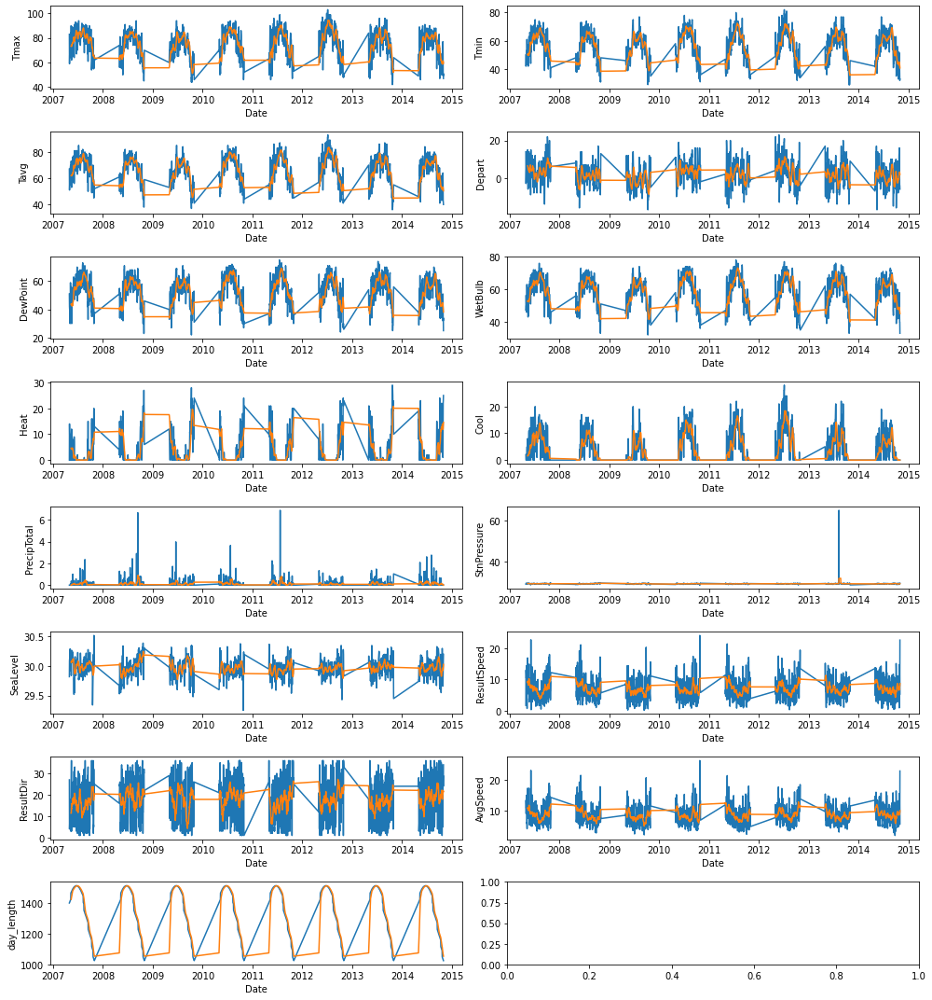

In [50]:
#plot time series subplots to look at the seasonlity of weather features and check for abnormality
subplot_rolling(dataframe=weather,
                   yvar ='Date',
                  list_of_xvars=cols)

# Clear seasonality present. suggest yearly seasonality
# Drop StationPressure above 35. Seems to be unusual. could be due to input error

In [51]:
# Drop 1 row with abnormally high StnPressure
weather.drop(weather[weather['StnPressure']>35].index,inplace=True)

In [52]:
# Merge the train and weather dataframes on the Date column
train_weather = pd.merge(train, weather, on='Date')

In [53]:
# View the first 3 rows of our merged dataframe
train_weather.head(3)

,Date,Species,Street,Trap,Latitude,Longitude,NumMosquitos,WnvPresent,day,week,month,year,Station,Tmax,Tmin,Tavg,Depart,DewPoint,WetBulb,Heat,Cool,PrecipTotal,StnPressure,SeaLevel,ResultSpeed,ResultDir,AvgSpeed,day_length,heavy_rain_last_14_days_count,light_rain_last_14_days_count,Tmax_rolling_14,Tmin_rolling_14,Tavg_rolling_14,Depart_rolling_14,DewPoint_rolling_14,WetBulb_rolling_14,Heat_rolling_14,Cool_rolling_14,PrecipTotal_rolling_14,StnPressure_rolling_14,SeaLevel_rolling_14,ResultSpeed_rolling_14,ResultDir_rolling_14,AvgSpeed_rolling_14,day_length_rolling_14
0,2007-05-29,CULEX PIPIENS/RESTUANS,N OAK PARK AVE,T002,41.954690,-87.800991,1,0,149,22,5,2007,1,88,60,74.0,10.0,58,65.0,0.0,9.0,0.0,29.39,30.11,5.8,18.0,6.5,1496,2.0,2.0,76.357143,51.571429,64.142857,2.928571,45.285714,54.142857,3.714286,2.857143,0.092143,29.402143,30.124286,8.214286,16.928571,9.85,1486.071429
1,2007-05-29,CULEX RESTUANS,N OAK PARK AVE,T002,41.954690,-87.800991,1,0,149,22,5,2007,1,88,60,74.0,10.0,58,65.0,0.0,9.0,0.0,29.39,30.11,5.8,18.0,6.5,1496,2.0,2.0,76.357143,51.571429,64.142857,2.928571,45.285714,54.142857,3.714286,2.857143,0.092143,29.402143,30.124286,8.214286,16.928571,9.85,1486.071429
2,2007-05-29,CULEX RESTUANS,N MANDELL AVE,T007,41.994991,-87.769279,1,0,149,22,5,2007,1,88,60,74.0,10.0,58,65.0,0.0,9.0,0.0,29.39,30.11,5.8,18.0,6.5,1496,2.0,2.0,76.357143,51.571429,64.142857,2.928571,45.285714,54.142857,3.714286,2.857143,0.092143,29.402143,30.124286,8.214286,16.928571,9.85,1486.071429


## Feature Engineering: Spray

Spray clusters are created and visualized where spraying occurred using DBSCAN. Since the spraying occurs in distance based clusters, DBSCAN was selected to perform the unsupervised clustering. DBSCAN uses two parameters, eps (the minimum distance between two points) and minPoints (the minimum number of points to form a dense region). The Spray clusters are subsequently overlayed on locations with WNV presence.

/Users/ethan/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


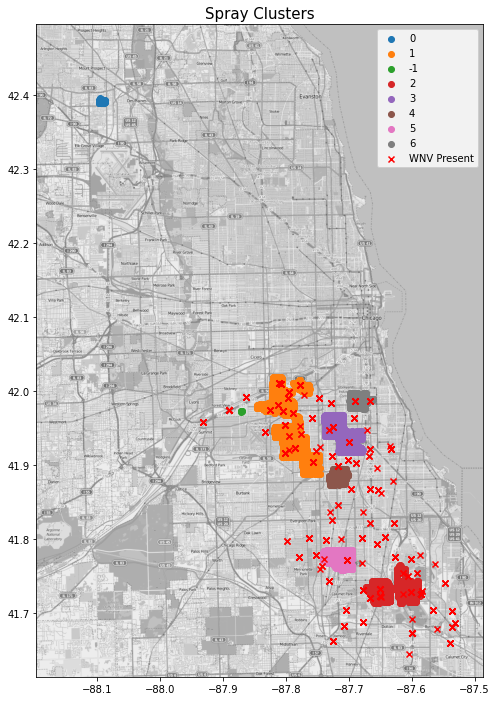

In [54]:
#use DBSCAN to cluster spray data to use to create spray cluster feature
X_spray = spray[['Latitude', 'Longitude']] #isolate lat long data
spray_cluster_model = DBSCAN(eps=.01, min_samples=20).fit(X_spray) #run DBSCAN 
X_spray['cluster'] = spray_cluster_model.labels_ #create cluster feature 
#set dimensions of plot
lon_lat_box_spray = (X_spray['Longitude'].min()-.1, X_spray['Longitude'].max()+.1, X_spray['Latitude'].min()-.1,X_spray['Latitude'].max()+.1)

#create plot of spray clusters, for loop allows for legend to represent clusters 
fig, ax = plt.subplots(figsize=(8,12))
mapdata = np.loadtxt('../data/mapdata_copyright_openstreetmap_contributors.txt')
ax.imshow(mapdata, cmap=plt.get_cmap('gray'), aspect='auto', extent=lon_lat_box_spray) 

#iterate through each cluster value and plot points in the same figure (maintains lables)
for i in X_spray['cluster'].unique():  
    ax.scatter(X_spray[X_spray['cluster'] == i]['Longitude'], 
               X_spray[X_spray['cluster'] == i]['Latitude'], 
               label=i, marker='o')

#overlay WNV presence
plt.scatter(train_weather[train_weather['WnvPresent'] == 1]['Longitude'], 
            train_weather[train_weather['WnvPresent'] == 1]['Latitude'], 
            marker='x', label='WNV Present', color='r')
plt.legend()
plt.title('Spray Clusters', size=15);

The add_cluster function adds the spray cluster feature using RandomForestClassifier to predict. Features are randomly selected to go into each split. This effectively makes individual decision trees less correlated, which decreases the variance of the predictions after aggregating the different decision trees. 

In [55]:
def add_clusters(df):
    X = X_spray[['Latitude', 'Longitude']]
    y = X_spray['cluster']
    rf1 = RandomForestClassifier()
    fit1 = rf1.fit(X, y)
    df['spray_cluster'] = fit1.predict(df[['Latitude','Longitude']])

    return df

In [56]:
# Run function to add cluster which can be thought of as adding spray data 
train_weather = add_clusters(train_weather)

In [57]:
# Display shape
train_weather.shape

(10506, 46)

# EDA

The dataset is imbalanced with WNV presence accounting for only 5% of dataset.

In [58]:
# Highly imbalanced class with WNV presence accounting for only 5% of dataset
train_weather['WnvPresent'].value_counts(normalize=True)

0    0.947554
1    0.052446
Name: WnvPresent, dtype: float64

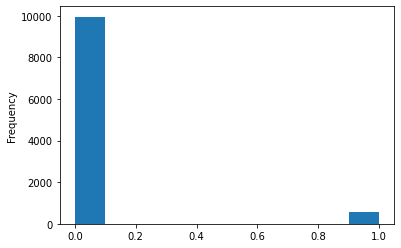

In [59]:
# Visualising the WNV presence in our dataset
train_weather['WnvPresent'].plot(kind='hist');

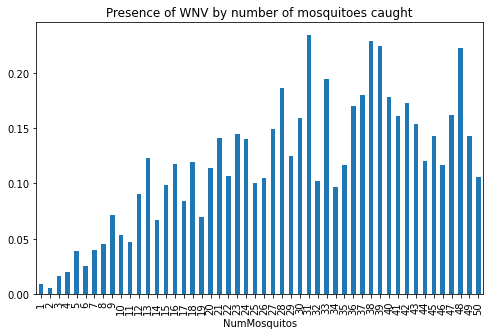

In [60]:
# Plot WNV presence against the number of mosquitoes caught
plt.figure(figsize=(8,5))
train_weather.groupby('NumMosquitos')['WnvPresent'].mean().plot(kind='bar')
plt.title('Presence of WNV by number of mosquitoes caught');

Presence of WNV increases as number of mosquitoes caught increases.

## Seasonality

In [61]:
# Plot time series to show that there is a seasonality effect in the mosquito breeding

train_by_wnv=pd.DataFrame(train_weather.groupby('Date')[['NumMosquitos','WnvPresent']].sum()).reset_index()

fig = px.line(train_by_wnv, x='Date', y='NumMosquitos',title='By no. of mosquitoes')


fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)


The mosquito population peaks in the month of August, across all years in our training dataset. 

In [62]:

fig = px.line(train_by_wnv, x='Date', y='WnvPresent',title='WnvPresent')


fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)

fig.show()

Similar to the number of mosquitos, the presence of WNV peaks in the month of August across all years in our dataset. WNV is also more prevalent in 2007 and 2013.

In [63]:
# Wrote a function to plot histogram subplots to compare the effects of seasonality
def subplot_histograms(dataframe, yvar, list_of_xvars, list_of_titles, list_of_xlabels, ylabel):
    nrows = int(np.ceil(len(list_of_xvars)/2)) 
    fig, ax = plt.subplots(nrows=nrows, ncols=2, figsize=(15,10)) 
    ax = ax.ravel() 
    for i, column in enumerate(list_of_xvars): # Gives us an index value to get into all our lists
        dataframe.groupby(column)[yvar].mean().plot(kind='bar', ax=ax[i])
        ax[i].set_title(list_of_titles[i])
        ax[i].set_xlabel(list_of_xlabels[i])
        ax[i].set_ylabel(ylabel)
    plt.tight_layout()

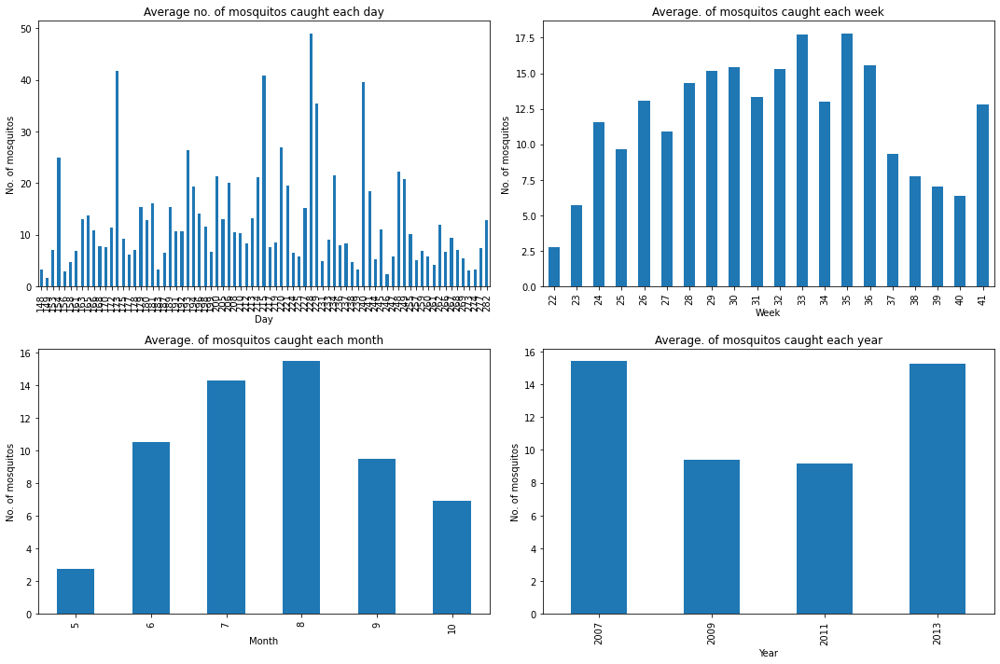

In [64]:
# Comparing the effects of sesonality on no. of mosquitos caught
subplot_histograms(dataframe=train_weather,
                   yvar ='NumMosquitos',
                  list_of_xvars=['day', 'week', 'month', 'year'],
                  list_of_titles=['Average no. of mosquitos caught each day', 'Average. of mosquitos caught each week', 'Average. of mosquitos caught each month', 'Average. of mosquitos caught each year'],
                  list_of_xlabels=['Day', 'Week', 'Month', 'Year'],
                  ylabel='No. of mosquitos')

There is indeed a seasonality impact on the number of mosquitos caught. August (month 8) and weeks 33 and 35 see much higher number of mosquitos caught than on average. These weeks and month are probably the most ideal weather conditions for mosquito breeding.

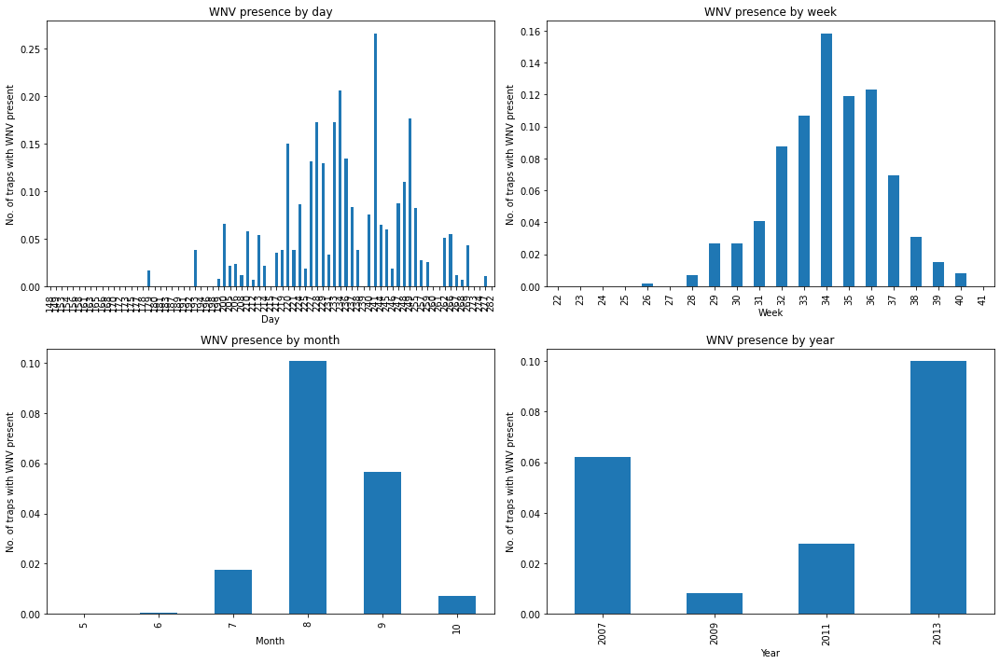

In [65]:
# Comparing the effects of sesonality on presence of WNV
subplot_histograms(dataframe=train_weather,
                   yvar ='WnvPresent',
                   list_of_xvars=['day', 'week', 'month', 'year'],
                   list_of_titles=['WNV presence by day', 'WNV presence by week', 'WNV presence by month', 'WNV presence by year'],
                   list_of_xlabels=['Day', 'Week', 'Month', 'Year'],
                   ylabel='No. of traps with WNV present')

While the previous plots illustrated the seasonality impact on the number of mosquitos caught in the traps, the narrative for the prevalence of WNV is very similiar. We observe a seasonality impact on the presence of WNV. There is a very clear influence of month 8, week 34 and possibly year 2013 on WNV presence. As such, we will use these variables, day, week, month and year, as features in our model.

## Ideal Weather Conditions

In [66]:
# Function to plot for number of mosquitos vs rolling variables
def subplot_rolling_14(dataframe, yvar, list_of_xvars):
    nrows = int(np.ceil(len(list_of_xvars)/2)) 
    fig, ax = plt.subplots(nrows=nrows, ncols=2, figsize=(15,25)) 
    ax = ax.ravel() 
    for i, column in enumerate(list_of_xvars): # Gives us an index value to get into all our lists
        ax[i].plot(dataframe[[column,yvar]].groupby([column], as_index=True).sum())
        ax[i].set_xlabel(str(column))
        ax[i].set_ylabel(str(yvar))
    plt.tight_layout()

In [67]:
# set columns list
cols_last_14_days = ['heavy_rain_last_14_days_count',
       'light_rain_last_14_days_count', 'Tmax_rolling_14', 'Tmin_rolling_14',
       'Tavg_rolling_14', 'Depart_rolling_14', 'DewPoint_rolling_14',
       'WetBulb_rolling_14', 'Heat_rolling_14', 'Cool_rolling_14',
       'PrecipTotal_rolling_14', 'StnPressure_rolling_14',
       'SeaLevel_rolling_14', 'ResultSpeed_rolling_14', 'ResultDir_rolling_14',
       'AvgSpeed_rolling_14', 'day_length_rolling_14']

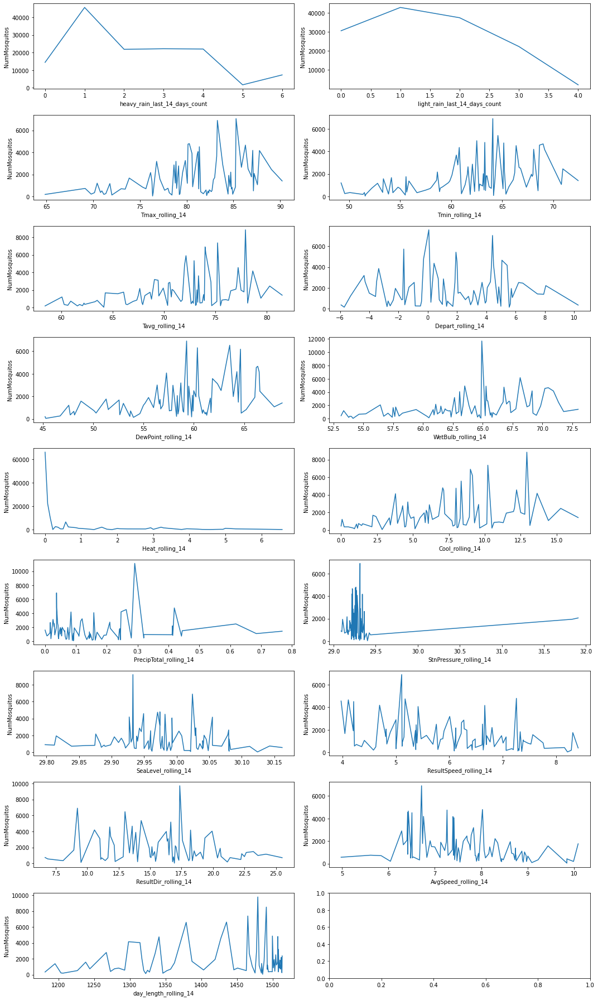

In [68]:
# Plot for number of mosquitos vs rolling variables
subplot_rolling_14(dataframe=train_weather,
                   yvar ='NumMosquitos',
                   list_of_xvars=cols_last_14_days)

# heavy rain counts for ~2-4 times prior to traps provide good habitat conditions for breeding. Of which there is a subsequent dip. Possibly due to the flushing out of these habitats?

The above line charts show that the number of mosquitos are dependent on the weather conditions. The number of mosquitos peak at the following weather conditions:
- if there was heavy/light rain once in the last 14 days
- high average temperature of around 77F
- medium wetbulb of 65
- medium precipitation level of 0.3
- low result speed around 6
- long day length of around 1480 (amount of sunlight time) 

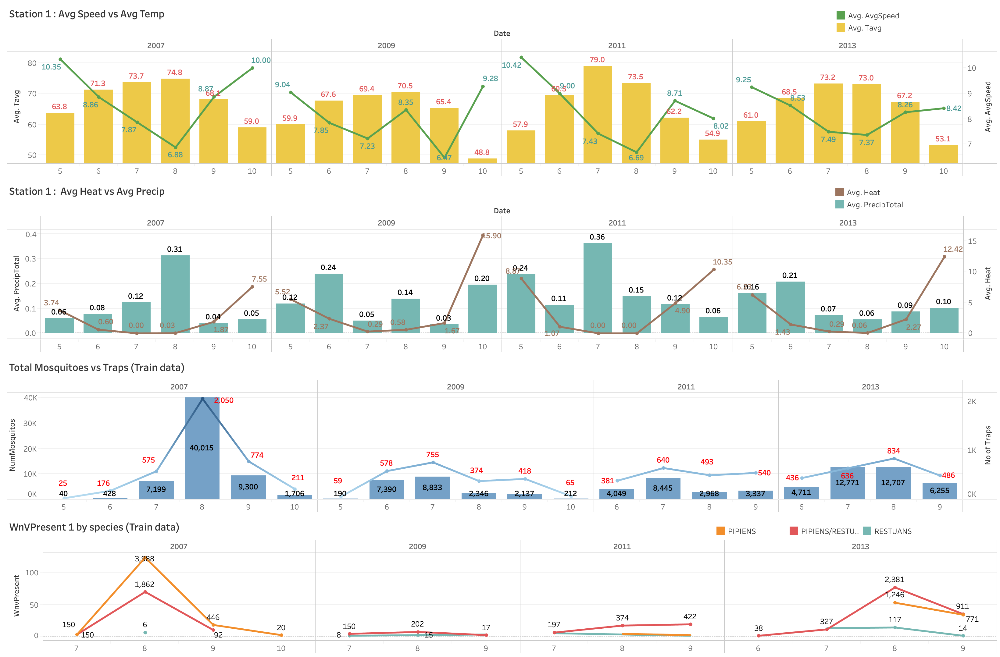

In [69]:
from IPython.display import Image
Image(filename="../img/Overview.png")


##### Observation: 
###### 1) There is a negative correlation between the wind speed and Avg Temp, the precipitation level and the no. of mosquitoes. 

2) Mosquitoes seem to breed faster in conditions where wind speed is low and both precipitation level + average temp are high.

3) The traps were deployed seasonally and the numbers tend to build up between Jul to Sep for the observed period.

In [70]:
from IPython.display import HTML
from base64 import b64encode

mp4 = open('../img/Mosquitoes cluster.mp4.mov','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML("""
<video width=1000 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

## Strategic Trap Placements

In [71]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open('../img/Traps.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML("""
<video width=1000 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

#### Observation: 
1) The mosquitoes clusters had moved from Southern area to the Northern area from the period 2007 to 2013 period.  

2) The presence of the WnV is also correlated to the mosquitoes cluster. 

3) We see that the traps are also more placed in a more strategic manner over the years.

## Spray

In [72]:
# Load spray data
spray1 = pd.read_csv('../data/spray.csv', parse_dates=['Date'])

# Round off decimals
spray1[['Latitude','Longitude']]=round(spray1[['Latitude','Longitude']],2)

# Groupby count
spray_group=spray1.groupby(['Date','Latitude','Longitude']).count()

# Reset index
spray_group.reset_index(inplace=True)

# rename columns
spray_group.rename(columns={'Time':'No_of_sprays'},inplace=True)

# Plotting the scatterplot
import plotly.express as px
fig = px.scatter(spray_group, x='Latitude', y='Longitude',color=pd.to_datetime(spray_group['Date']).dt.year, size='No_of_sprays', 
                 title="Spray Data by Location")


fig1 = px.scatter(spray_group, x='Date', y='Longitude',color='No_of_sprays', size='No_of_sprays',
                 title="Spray Data by Period")

fig1.update_xaxes(
    rangeslider_visible=True,
    tickformatstops = [
        dict(dtickrange=[None, 1000], value="%H:%M:%S.%L ms"),
        dict(dtickrange=[1000, 60000], value="%H:%M:%S s"),
        dict(dtickrange=[60000, 3600000], value="%H:%M m"),
        dict(dtickrange=[3600000, 86400000], value="%H:%M h"),
        dict(dtickrange=[86400000, 604800000], value="%e. %b d"),
        dict(dtickrange=[604800000, "M1"], value="%e. %b w"),
        dict(dtickrange=["M1", "M12"], value="%b '%y M"),
        dict(dtickrange=["M12", None], value="%Y Y")
    ]
)

fig.show()
fig1.show()

The spray locations based on the spray data correspond to spray cluster feature 1 and 3 generated previously.

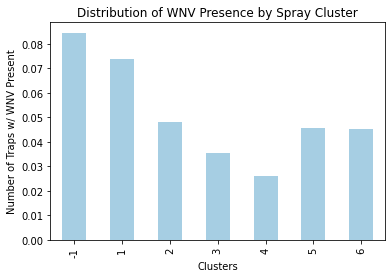

In [73]:
# Plotting distribution
ax = train_weather.groupby(by='spray_cluster')['WnvPresent'].mean().plot(kind='bar', 
                                                             colormap='Paired', 
                                                             title='Distribution of WNV Presence by Spray Cluster')
ax.set_xlabel('Clusters')
ax.set_ylabel('Number of Traps w/ WNV Present');

The chart above shows the prevalence of WNV by the spray clusters that we have engineered. It seems that clusters -1 and 1 have a higher prevalence of the WNV than average, above the 5% level in our dataset. As such, the spray clusters will be added as a feature in our model to see if it has predictive power in classifying WNV presence.

## WNV Hotspots 

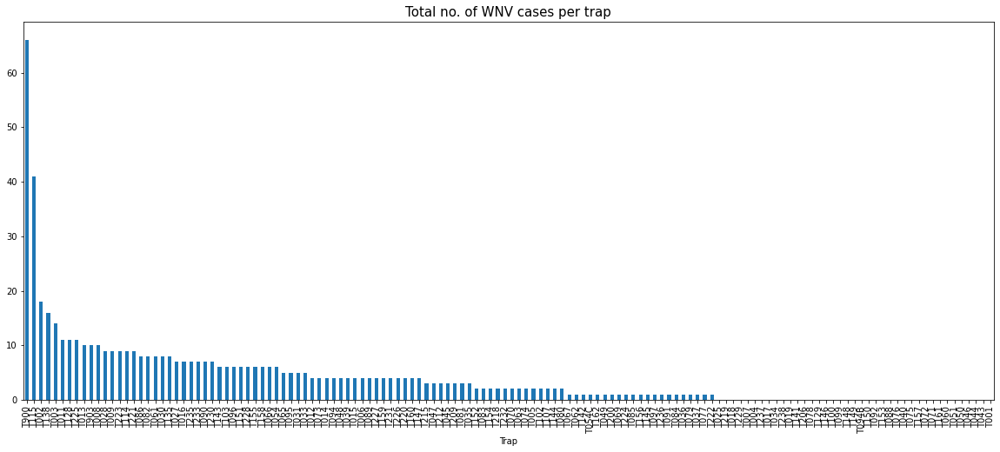

In [74]:
# Traps like T900 (Ohare Airport) and T115 (Doty) have higher prevalence of wnv
plt.figure(figsize=(20,8))
train_weather.groupby('Trap')['WnvPresent'].sum().sort_values(ascending=False).plot(kind='bar')
plt.title('Total no. of WNV cases per trap', fontsize=15);

By identifying traps (T900 and T115) with higher WNV presence, distance features 'dist_from_ohare' and 'dist_from_doty' are created to calculate the proximity to each hotspot respectively. 

In [75]:
# Create distance feature from the two hotspots, Ohare Airport and Doty

ohare_airport_coord = (41.974689, -87.890615) # cordinates for ohare - lat, lon
doty_coord = (41.673408, -87.599862) # cordinates for doty - lat, lon

train_weather['coordinates'] = list(zip(train_weather['Latitude'], train_weather['Longitude']))

# Calculates the distance of each location from ohare
train_weather['dist_from_ohare'] = [geopy.distance.distance(ohare_airport_coord, x).km for x in zip(train_weather['coordinates'])]

# Calculates the distance of each location from doty
train_weather['dist_from_doty'] = [geopy.distance.distance(doty_coord, x).km for x in zip(train_weather['coordinates'])]

## Prevalence of WNV By Species

The prevalence of WNV amongst the species *culex pipiens*, *culex pipiens/restuans* and *culex restuans* is evident.

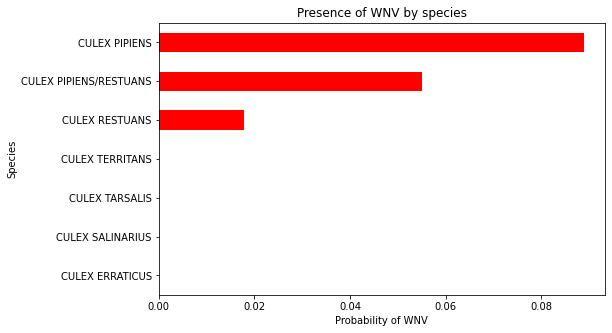

In [76]:
# WNV seems to be more prevalent among Pipiens, Pipiens/Restuans and Restuans
plt.figure(figsize=(8,5))
train_weather.groupby('Species')['WnvPresent'].mean().sort_values().plot(kind='barh', color='red')
plt.title('Presence of WNV by species')
plt.xlabel('Probability of WNV');

In [77]:
# Groupby mean
train_by_species=pd.DataFrame(train_weather.groupby(['Date','Species'])['WnvPresent'].mean()).reset_index()

In [78]:
# Time series of WNV presence by species
fig = px.line(train_by_species, x='Date', y='WnvPresent',title='WnV Present By Species',color='Species')


fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)

fig.show()

As our dataset shows that the WNV is only prevalent among culex pipiens, culex pipiens/restuans and culex restuans, we will one hot encode these species as features for our model.

In [79]:
# One hot encode mosquito species
train_weather = pd.get_dummies(train_weather, columns=['Species'], drop_first=True)

In [80]:
# Drop species that are not at risk of carrying WNV
train_weather = train_weather.drop(columns=['Species_CULEX SALINARIUS', 'Species_CULEX TARSALIS', 'Species_CULEX TERRITANS'], axis=1)

# Prepare Train and Test Set

We will now prepare our train and test datasets for modeling and prediction by only keeping the features that will be useful.

## Prepare train set

In [81]:
# Drop the following columns as we have engineering features from these. As NumMosquitos is not in our test set we will leave it out from our training set
cols_to_drop = ['Date', 'Street', 'Trap', 'NumMosquitos', 'Station', 'Tmax', 'Tmin',
       'Tavg', 'Depart', 'DewPoint', 'WetBulb', 'Heat', 'Cool', 'PrecipTotal',
       'StnPressure', 'SeaLevel', 'ResultSpeed', 'ResultDir', 'AvgSpeed', 'coordinates', 'day_length']

train_weather = train_weather.drop(cols_to_drop, axis=1)

In [82]:
# Convert all columns to lowercase and replace spaces with underscores
train_weather.columns = [x.lower().replace(' ','_') for x in train_weather.columns]

In [83]:
# Display columns
train_weather.columns

Index(['latitude', 'longitude', 'wnvpresent', 'day', 'week', 'month', 'year',
       'heavy_rain_last_14_days_count', 'light_rain_last_14_days_count',
       'tmax_rolling_14', 'tmin_rolling_14', 'tavg_rolling_14',
       'depart_rolling_14', 'dewpoint_rolling_14', 'wetbulb_rolling_14',
       'heat_rolling_14', 'cool_rolling_14', 'preciptotal_rolling_14',
       'stnpressure_rolling_14', 'sealevel_rolling_14',
       'resultspeed_rolling_14', 'resultdir_rolling_14', 'avgspeed_rolling_14',
       'day_length_rolling_14', 'spray_cluster', 'dist_from_ohare',
       'dist_from_doty', 'species_culex_pipiens',
       'species_culex_pipiens/restuans', 'species_culex_restuans'],
      dtype='object')

In [84]:
# Check that there are no null values in the training set
train_weather.isnull().sum().sum()

0

In [85]:
# Save final training set as clean_train_weather.csv
train_weather.to_csv('../data/clean_train_weather.csv', index=False)

## Prepare test set

In [86]:
# Breakdown the Date into day, week, month and year
test['day'] = test['Date'].dt.dayofyear
test['week'] = test['Date'].dt.week
test['month'] = test['Date'].dt.month
test['year'] = test['Date'].dt.year

# Merge the test and weather dataframes on the Date column
test_weather = pd.merge(test, weather, on='Date')

# Add spray clusters to model the possible spray areas in the test set
test_weather = add_clusters(test_weather)

# Create coordinates for each location
test_weather['coordinates'] = list(zip(test_weather['Latitude'], test_weather['Longitude']))

# Create distance feature from the two hotspots, Ohare Airport and Doty
test_weather['dist_from_ohare'] = [geopy.distance.distance(ohare_airport_coord, x).km for x in zip(test_weather['coordinates'])]
test_weather['dist_from_doty'] = [geopy.distance.distance(doty_coord, x).km for x in zip(test_weather['coordinates'])]

# One hot encode mosquito species
test_weather = pd.get_dummies(test_weather,columns=['Species'],drop_first=True)

# Drop species that are not at risk of carrying WNV
test_weather = test_weather.drop(columns=['Species_CULEX SALINARIUS', 'Species_CULEX TARSALIS', 'Species_CULEX TERRITANS', 'Species_UNSPECIFIED CULEX'], axis=1)

# Drop test_weather columns that are not in train_weather
cols_to_drop = ['Date', 'Address', 'Block', 'Street', 'Trap','AddressNumberAndStreet', 'AddressAccuracy',
                'Station', 'Tmax', 'Tmin', 'Tavg','Depart', 'DewPoint', 'WetBulb', 'Heat', 'Cool', 'PrecipTotal',
                'StnPressure', 'SeaLevel', 'ResultSpeed', 'ResultDir', 'AvgSpeed', 'coordinates', 'day_length']
test_weather = test_weather.drop(cols_to_drop, axis=1)

In [87]:
# Convert all columns to lowercase and replace spaces with underscores
test_weather.columns = [x.lower().replace(' ','_') for x in test_weather.columns]

In [88]:
# Sense check all columns
test_weather.columns

Index(['id', 'latitude', 'longitude', 'day', 'week', 'month', 'year',
       'heavy_rain_last_14_days_count', 'light_rain_last_14_days_count',
       'tmax_rolling_14', 'tmin_rolling_14', 'tavg_rolling_14',
       'depart_rolling_14', 'dewpoint_rolling_14', 'wetbulb_rolling_14',
       'heat_rolling_14', 'cool_rolling_14', 'preciptotal_rolling_14',
       'stnpressure_rolling_14', 'sealevel_rolling_14',
       'resultspeed_rolling_14', 'resultdir_rolling_14', 'avgspeed_rolling_14',
       'day_length_rolling_14', 'spray_cluster', 'dist_from_ohare',
       'dist_from_doty', 'species_culex_pipiens',
       'species_culex_pipiens/restuans', 'species_culex_restuans'],
      dtype='object')

In [89]:
# Check that no features were missed out 
# Test set contains an additional column for 'id' while the training set contains 'wnvpresent'
print(test_weather.columns.difference(train_weather.columns))
print(train_weather.columns.difference(test_weather.columns))

Index(['id'], dtype='object')
Index(['wnvpresent'], dtype='object')


In [90]:
# Check that there are no null values in the test set
test_weather.isnull().sum().sum()

0

In [91]:
# Save final test_weather file as clean_test.csv
test_weather.to_csv('../data/clean_test.csv', index=False)

# Sources

<sup>1</sup> https://www.kaggle.com/c/predict-west-nile-virus/overview <br/>
<sup>2</sup> https://www.ncdc.noaa.gov/<br/>
<sup>3</sup> https://www.mosquito.org/page/lifecycle<br/>
<sup>4</sup> https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3322011/<br/>
<sup>5 </sup> https://www.nytimes.com/2002/08/11/nyregion/mosquito-control-weighing-costs-versus-benefits.html<br/>
<sup>6</sup> https://www.usinflationcalculator.com/<br/>
<sup>7 </sup> https://www.census.gov/glossary/#term_Populationestimates<br/>
<sup>8 </sup> https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3291438/<br/>

# Acknowledgements 
This kaggle challenge provided by General Assembly is sponsored by the Robert Wood Johnson Foundation. Data is provided by the Chicago Department of Public Health.